In [ ]:
!unzip chid.zip


unzip:  cannot find or open chid.zip, chid.zip.zip or chid.zip.ZIP.


In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from PIL import UnidentifiedImageError


# Data Preprocessing

In [ ]:
%ls /content


In [ ]:
data_dir = '/content'
train_dir = os.path.join(data_dir, 'train')
valid_dir = os.path.join(data_dir, 'valid')
test_dir = os.path.join(data_dir, 'test')

In [ ]:
# Check if there are valid images in the training directory
image_files = [f for f in os.listdir(train_dir) if os.path.isfile(os.path.join(train_dir, f))]
if not image_files:
    raise ValueError("No image files found in the training directory.")

In [ ]:
# Load and preprocess the dataset
images = []
labels = []

In [ ]:
for filename in image_files:
    img_path = os.path.join(train_dir, filename)

    # Add print statements to debug
    print(f"Loading image: {img_path}")

    try:
        # Check if the entry is a file before attempting to load it
        if os.path.isfile(img_path):
            img = tf.keras.preprocessing.image.load_img(
                img_path,
                target_size=(224, 224)
            )
            img_array = tf.keras.preprocessing.image.img_to_array(img)
            images.append(img_array)
            # Extract label from the filename
            labels.append(filename.split('_')[0])
    except (tf.errors.InvalidArgumentError, UnidentifiedImageError):
        print(f"Skipping invalid image: {img_path}")
        continue

print(f"Number of images: {len(images)}")
print(f"Number of labels: {len(labels)}")
print(f"Unique labels: {np.unique(labels)}")



Loading image: /content/train/im200_png_jpg.rf.86134ad03cbff8abcf627322c644b1d4.jpg
Loading image: /content/train/52_png_jpg.rf.1ac0e6dfcca7d2c6f139c8b5e9f6e263.jpg
Loading image: /content/train/133_png_jpg.rf.92d7b05514f474dec6e0927616b04519.jpg
Loading image: /content/train/71_png_jpg.rf.ed8006be27481b743ec6f1bb25424a63.jpg
Loading image: /content/train/64_png_jpg.rf.76ec113f26510dc12c5823215059fa23.jpg
Loading image: /content/train/145_png_jpg.rf.476cabf260bf61251508d35d785b669c.jpg
Loading image: /content/train/im1853_png_jpg.rf.49d91e51b1db90aa7cc5bf833b1871c5.jpg
Loading image: /content/train/86_png_jpg.rf.58cb04a900bcf1ea19c15e9d87d93636.jpg
Loading image: /content/train/96_png_jpg.rf.2f25ee58b84e732ab62e2575c2b4974f.jpg
Loading image: /content/train/im2044_png_jpg.rf.7045c8c8f2f85cdac2e281ad6b1d68ff.jpg
Loading image: /content/train/98_png_jpg.rf.356175bac603d0db4f93359aaef4293c.jpg
Loading image: /content/train/153_png_jpg.rf.ea23bc82150fced5111f8bb50e9b3591.jpg
Loading image:

In [ ]:
# Check if there are any valid samples
if len(images) == 0:
    raise ValueError("No valid samples found in the training directory.")

# Normalize pixel values
images = np.array(images) / 255.0

# One-hot encode the target labels
label_encoder = LabelEncoder()
labels_encoded = label_encoder.fit_transform(labels)
labels_one_hot = tf.keras.utils.to_categorical(labels_encoded)


# Split the Dataset

In [ ]:
X_train, X_temp, y_train, y_temp = train_test_split(images, labels_one_hot, test_size=0.4, random_state=42)
X_valid, X_test, y_valid, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)


# Build the Convolutional Neural Network (CNN)

In [ ]:
model = models.Sequential([
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(128, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dense(128, activation='relu'),
    layers.Dense(len(np.unique(labels)), activation='softmax')  # Output layer with the number of unique labels
])

In [ ]:

# Step 5: Compile the Model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


In [ ]:
# Step 6: Train the Model
model.fit(X_train, y_train, epochs=25, validation_data=(X_valid, y_valid))

Epoch 1/2
44/44 [==============================] - 166s 4s/step - loss: 6.4235 - accuracy: 0.0022 - val_loss: 6.3719 - val_accuracy: 0.0022
Epoch 2/2
44/44 [==============================] - 157s 4s/step - loss: 6.2129 - accuracy: 0.0058 - val_loss: 6.3219 - val_accuracy: 0.0022


In [ ]:
# Step 7: Evaluate the Model
test_loss, test_acc = model.evaluate(X_test, y_test)
print(f'Test accuracy: {test_acc}')

15/15 [==============================] - 12s 786ms/step - loss: 6.3425 - accuracy: 0.0022
Test accuracy: 0.0021739129442721605


44/44 [==============================] - 168s 4s/step - loss: 6.0501 - accuracy: 0.0051 - val_loss: 6.3581 - val_accuracy: 0.0022


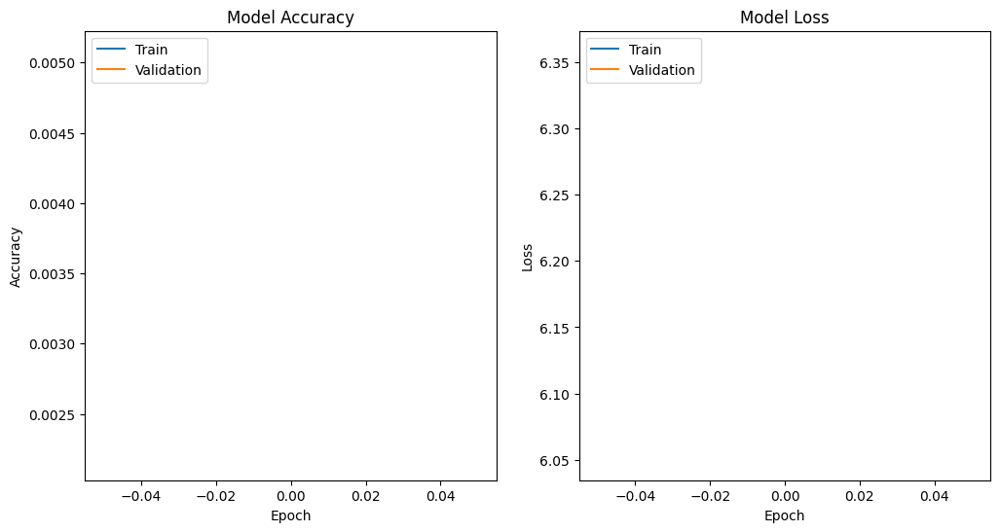

15/15 [==============================] - 13s 871ms/step - loss: 6.4348 - accuracy: 0.0022
Test accuracy: 0.0021739129442721605
15/15 [==============================] - 13s 873ms/step
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         2
           1       0.00      0.00      0.00         1
           2       0.00      0.00      0.00         1
           3       0.00      0.00      0.00         2
           4       0.00      0.00      0.00         2
           5       0.00      0.00      0.00         2
           6       0.00      0.00      0.00         1
           7       0.00      0.00      0.00         2
           8       0.00      0.00      0.00         1
           9       0.00      0.00      0.00         1
          10       0.00      0.00      0.00         2
          11       0.00      0.00      0.00         1
          14       0.00      0.00      0.00         1
          15       0.00      0.00    

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix

# Step 5: Compile the Model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Step 6: Train the Model
history = model.fit(X_train, y_train, epochs=1, validation_data=(X_valid, y_valid))

# Plot training history
def plot_history(history):
    plt.figure(figsize=(12, 6))

    # Plot training & validation accuracy values
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(['Train', 'Validation'], loc='upper left')

    # Plot training & validation loss values
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend(['Train', 'Validation'], loc='upper left')

    plt.show()

plot_history(history)

# Step 7: Evaluate the Model
test_loss, test_acc = model.evaluate(X_test, y_test)
print(f'Test accuracy: {test_acc}')




In [ ]:

#  Calculate and print classification report and confusion matrix
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)
y_test_classes = np.argmax(y_test, axis=1)

print("Classification Report:")
print(classification_report(y_test_classes, y_pred_classes))

print("Confusion Matrix:")
print(confusion_matrix(y_test_classes, y_pred_classes))

# Alarm functionality

In [ ]:
!pip install librosa
from IPython.display import Audio
import librosa
import numpy as np

# Assuming 'bad' emotion corresponds to class 0
threshold = 0.5

# Step 8: Make Predictions
predictions = model.predict(X_test)

# Check if predicted probability of 'bad' emotion is below the threshold
bad_emotion_probs = predictions[:, 0]
alarm_triggered = any(prob < threshold for prob in bad_emotion_probs)

# Step 9: Set Up an Alarm
if alarm_triggered:
    # Provide the correct file path for the alarm sound
    alarm_sound_path = 'Anne_Marie_Alarm_Official_Video_.mp3'

    # Load the alarm sound and get the sample rate
    alarm_data, alarm_rate = librosa.load(alarm_sound_path, sr=None)

    # Create the Audio object for the alarm
    alarm_audio = Audio(data=alarm_data, rate=alarm_rate, autoplay=True)
    display(alarm_audio)


15/15 [==============================] - 13s 857ms/step
